In [1]:
# pip list

In [2]:
# !apt update && apt install -y libpq-dev libsdl2-dev swig xorg-dev xvfb
# # %pip uninstall gym
# %pip install -U tf-agents pyvirtualdisplay
# %pip install -U gym~=0.21.0
# # %pip install gym[atari,accept-rom-license]==0.21.0


# # %pip install -U atari-py
# # %pip install -U ale-py
# %pip install -U gym[box2d,atari,accept-rom-license]==0.21.0
# %pip install opencv-python

In [1]:
import sklearn
assert sklearn.__version__ >= "0.20"

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"

# Common imports
import numpy as np
import os

import jupyter_beeper
import time

# to make this notebook's output stable across runs
np.random.seed(42)
tf.random.set_seed(42)

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# To get smooth animations
import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')

game_name = "SpaceInvaders-v0"

PROJECT_ROOT_DIR = "."
CHAPTER_ID = "rl"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

2022-12-09 18:14:09.611164: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-12-09 18:14:09.772245: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2022-12-09 18:14:10.527388: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda/lib64:/usr/local/nccl2/lib:/usr/local/cuda/extras/CUPTI/lib64
2022-12-09 18:14:10.527535: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer

In [2]:
import gym
gym.envs.registry.all()

dict_values([EnvSpec(ALE/Tetris-v5), EnvSpec(ALE/Tetris-ram-v5), EnvSpec(ALE/Darkchambers-v5), EnvSpec(ALE/Darkchambers-ram-v5), EnvSpec(ALE/RoadRunner-v5), EnvSpec(ALE/RoadRunner-ram-v5), EnvSpec(ALE/Hero-v5), EnvSpec(ALE/Hero-ram-v5), EnvSpec(ALE/BattleZone-v5), EnvSpec(ALE/BattleZone-ram-v5), EnvSpec(ALE/Pitfall2-v5), EnvSpec(ALE/Pitfall2-ram-v5), EnvSpec(ALE/UpNDown-v5), EnvSpec(ALE/UpNDown-ram-v5), EnvSpec(ALE/SpaceWar-v5), EnvSpec(ALE/SpaceWar-ram-v5), EnvSpec(ALE/Entombed-v5), EnvSpec(ALE/Entombed-ram-v5), EnvSpec(ALE/Koolaid-v5), EnvSpec(ALE/Koolaid-ram-v5), EnvSpec(ALE/Phoenix-v5), EnvSpec(ALE/Phoenix-ram-v5), EnvSpec(ALE/Robotank-v5), EnvSpec(ALE/Robotank-ram-v5), EnvSpec(ALE/BasicMath-v5), EnvSpec(ALE/BasicMath-ram-v5), EnvSpec(ALE/Pacman-v5), EnvSpec(ALE/Pacman-ram-v5), EnvSpec(ALE/Amidar-v5), EnvSpec(ALE/Amidar-ram-v5), EnvSpec(ALE/Kangaroo-v5), EnvSpec(ALE/Kangaroo-ram-v5), EnvSpec(ALE/ChopperCommand-v5), EnvSpec(ALE/ChopperCommand-ram-v5), EnvSpec(ALE/ElevatorAction-v5),

In [3]:
# import atari_py
# atari_py.list_games()

In [4]:
tf.random.set_seed(42)
np.random.seed(42)

In [5]:
from tf_agents.environments import suite_gym
import ale_py

env = gym.make(game_name)
env

A.L.E: Arcade Learning Environment (version 0.7.5+db37282)
[Powered by Stella]


<TimeLimit<AtariEnv<SpaceInvaders-v0>>>

In [6]:
env.gym

AttributeError: 'AtariEnv' object has no attribute 'gym'

In [ ]:
env.seed(42)
env.reset()


In [7]:
env.step(1) # Fire


AssertionError: Cannot call env.step() before calling reset()

Saving figure spaceinvaders_plot


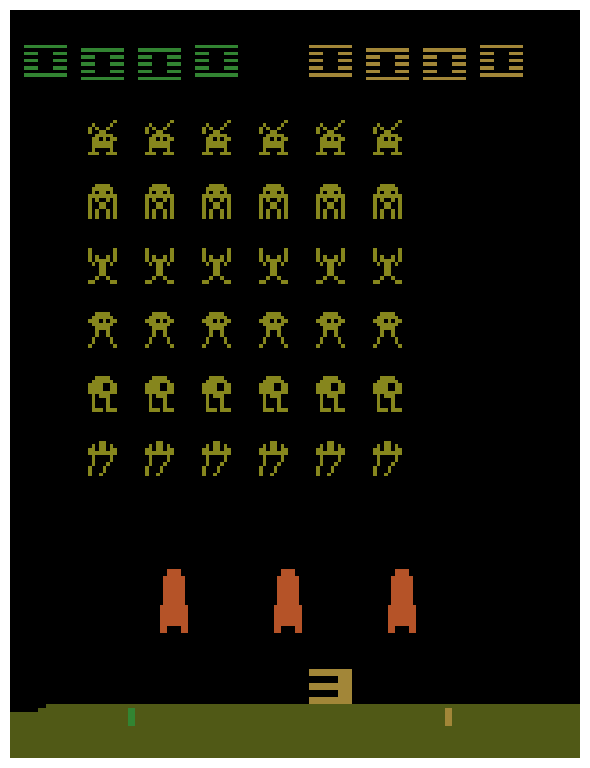

In [8]:
img = env.render(mode="rgb_array")

plt.figure(figsize=(6, 8))
plt.imshow(img)
plt.axis("off")
save_fig("spaceinvaders_plot")
plt.show()


In [9]:
env.current_time_step()


AttributeError: 'AtariEnv' object has no attribute 'current_time_step'

In [10]:
env.observation_spec()


AttributeError: 'AtariEnv' object has no attribute 'observation_spec'

In [11]:
env.action_spec()


AttributeError: 'AtariEnv' object has no attribute 'action_spec'

In [12]:
from tf_agents.environments.wrappers import ActionRepeat

repeating_env = ActionRepeat(env, times=4)
repeating_env


In [13]:
repeating_env.unwrapped


In [14]:
import tf_agents.environments.wrappers

for name in dir(tf_agents.environments.wrappers):
    obj = getattr(tf_agents.environments.wrappers, name)
    if hasattr(obj, "__base__") and issubclass(obj, tf_agents.environments.wrappers.PyEnvironmentBaseWrapper):
        print("{:27s} {}".format(name, obj.__doc__.split("\n")[0]))


ActionClipWrapper           Wraps an environment and clips actions to spec before applying.
ActionDiscretizeWrapper     Wraps an environment with continuous actions and discretizes them.
ActionOffsetWrapper         Offsets actions to be zero-based.
ActionRepeat                Repeates actions over n-steps while acummulating the received reward.
ExtraDisabledActionsWrapper Adds extra unavailable actions.
FixedLength                 Truncates long episodes and pads short episodes to have a fixed length.
FlattenActionWrapper        Flattens the action.
FlattenObservationsWrapper  Wraps an environment and flattens nested multi-dimensional observations.
GoalReplayEnvWrapper        Adds a goal to the observation, used for HER (Hindsight Experience Replay).
HistoryWrapper              Adds observation and action history to the environment's observations.
ObservationFilterWrapper    Filters observations based on an array of indexes.
OneHotActionWrapper         Converts discrete action to one_h

In [15]:
from functools import partial
from gym.wrappers import TimeLimit

limited_repeating_env = suite_gym.load(
    game_name,
    gym_env_wrappers=[partial(TimeLimit, max_episode_steps=100)],
    env_wrappers=[partial(ActionRepeat, times=4)],
)

In [16]:
limited_repeating_env

In [17]:
limited_repeating_env.unwrapped

In [18]:
from tf_agents.environments import suite_atari
from tf_agents.environments.atari_preprocessing import AtariPreprocessing
from tf_agents.environments.atari_wrappers import FrameStack4

max_episode_steps = 27000 # <=> 108k ALE frames since 1 step = 4 frames
environment_name = "SpaceInvaders-v0"
# SpaceInvadersNoFrameskip-v4

# class AtariPreprocessingWithAutoFire(AtariPreprocessing):
#     def reset(self, **kwargs):
#         obs = super().reset(**kwargs)
#         super().step(1) # FIRE to start
#         return obs
#     def step(self, action):
#         lives_before_action = self.ale.lives()
#         obs, rewards, done, info = super().step(action)
#         if self.ale.lives() < lives_before_action and not done:
#             super().step(1) # FIRE to start after life lost
#         return obs, rewards, done, info

class AtariPreprocessingWithSkipStart(AtariPreprocessing):
    def skip_frames(self, num_skip):
        for _ in range(num_skip):
          super().step(0) # NOOP for num_skip steps
    def reset(self, **kwargs):
        obs = super().reset(**kwargs)
        self.skip_frames(40)
        return obs
    def step(self, action):
        lives_before_action = self.ale.lives()
        obs, rewards, done, info = super().step(action)
        if self.ale.lives() < lives_before_action and not done:
            self.skip_frames(40)
        return obs, rewards, done, info

env = suite_atari.load(
    environment_name,
    max_episode_steps=max_episode_steps,
    gym_env_wrappers=[AtariPreprocessingWithSkipStart, FrameStack4])



In [19]:
env


In [20]:
env.seed(42)
env.reset()
for _ in range(4):
    time_step = env.step(3) # LEFT

In [21]:
def plot_observation(obs):
    # Since there are only 3 color channels, you cannot display 4 frames
    # with one primary color per frame. So this code computes the delta between
    # the current frame and the mean of the other frames, and it adds this delta
    # to the red and blue channels to get a pink color for the current frame.
    obs = obs.astype(np.float32)
    img = obs[..., :3]
    current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
    img[..., 0] += current_frame_delta
    img[..., 2] += current_frame_delta
    img = np.clip(img / 150, 0, 1)
    plt.imshow(img)
    plt.axis("off")

Saving figure preprocessed_breakout_plot


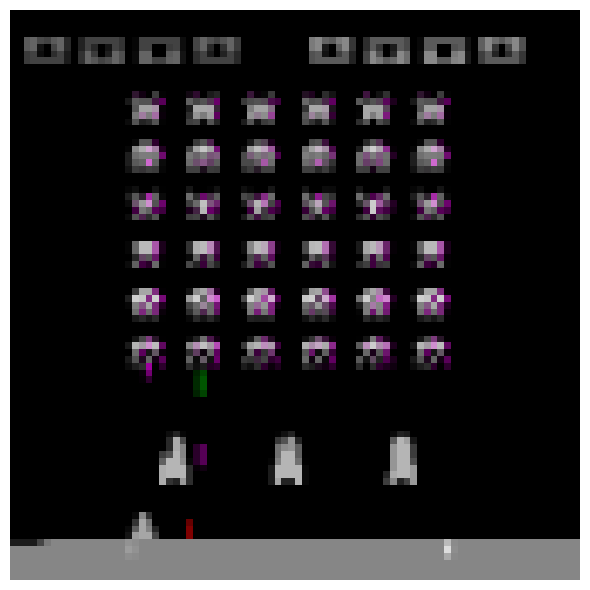

In [22]:

plt.figure(figsize=(6, 6))
plot_observation(time_step.observation)
save_fig("preprocessed_breakout_plot")
plt.show()

In [23]:
from tf_agents.environments.tf_py_environment import TFPyEnvironment

tf_env = TFPyEnvironment(env)

In [24]:
from tf_agents.networks.q_network import QNetwork

preprocessing_layer = keras.layers.Lambda(
                          lambda obs: tf.cast(obs, np.float32) / 255.)
conv_layer_params=[(32, (8, 8), 4), (64, (4, 4), 2), (64, (3, 3), 1)]
fc_layer_params=[512]

q_net = QNetwork(
    tf_env.observation_spec(),
    tf_env.action_spec(),
    preprocessing_layers=preprocessing_layer,
    conv_layer_params=conv_layer_params,
    fc_layer_params=fc_layer_params)

In [25]:
from tf_agents.agents.dqn.dqn_agent import DqnAgent

train_step = tf.Variable(0) # globak_step substitute
update_period = 4 # run a training step every 4 collect steps
optimizer = keras.optimizers.RMSprop(learning_rate=2.5e-4, rho=0.95, momentum=0.0,
                                     epsilon=0.00001, centered=True)
epsilon_fn = keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=1.0, # initial ε
    decay_steps=25000// update_period, # <=> 1,000,000 ALE frames
    end_learning_rate=0.01) # final ε
agent = DqnAgent(tf_env.time_step_spec(),
                 tf_env.action_spec(),
                 q_network=q_net,
                 optimizer=optimizer,
                 target_update_period=2000, # <=> 32,000 ALE frames
                 td_errors_loss_fn=keras.losses.Huber(reduction="none"),
                 gamma=0.99, # discount factor
                 train_step_counter=train_step,
                 epsilon_greedy=lambda: epsilon_fn(train_step))
agent.initialize()

2022-12-09 18:15:20.107073: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-12-09 18:15:20.246828: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-12-09 18:15:20.249779: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-12-09 18:15:20.254309: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

In [26]:
from tf_agents.replay_buffers import tf_uniform_replay_buffer

replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer(
    data_spec=agent.collect_data_spec,
    batch_size=tf_env.batch_size,
    max_length=100000) # reduce if OOM error

replay_buffer_observer = replay_buffer.add_batch

2022-12-09 18:15:32.440291: W tensorflow/core/framework/cpu_allocator_impl.cc:82] Allocation of 2822400000 exceeds 10% of free system memory.


In [27]:
class ShowProgress:
    def __init__(self, total):
        self.counter = 0
        self.total = total
    def __call__(self, trajectory):
        if not trajectory.is_boundary():
            self.counter += 1
        if self.counter % 100 == 0:
            print("\r{}/{}".format(self.counter, self.total), end="")



In [28]:
from tf_agents.metrics import tf_metrics

train_metrics = [
    tf_metrics.NumberOfEpisodes(),
    tf_metrics.EnvironmentSteps(),
    tf_metrics.AverageReturnMetric(),
    tf_metrics.AverageEpisodeLengthMetric(),
]


In [29]:
train_metrics[0].result()


<tf.Tensor: shape=(), dtype=int64, numpy=0>

In [34]:
from tf_agents.eval.metric_utils import log_metrics
import logging
logging.getLogger().setLevel(logging.INFO)
log_metrics(train_metrics)

INFO:absl: 
		 NumberOfEpisodes = 0
		 EnvironmentSteps = 0
		 AverageReturn = 0.0
		 AverageEpisodeLength = 0.0


In [35]:
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver

collect_driver = DynamicStepDriver(
    tf_env,
    agent.collect_policy,
    observers=[replay_buffer_observer] + train_metrics,
    num_steps=update_period) # collect 4 steps for each training iteration



In [32]:

from tf_agents.policies.random_tf_policy import RandomTFPolicy

ale_frames = 20000

initial_collect_policy = RandomTFPolicy(tf_env.time_step_spec(),
                                        tf_env.action_spec())
init_driver = DynamicStepDriver(
    tf_env,
    initial_collect_policy,
    observers=[replay_buffer.add_batch, ShowProgress(ale_frames)],
    num_steps=ale_frames) # <=> 80,000 ALE frames
final_time_step, final_policy_state = init_driver.run()

20000/20000

In [37]:
tf.random.set_seed(9) # chosen to show an example of trajectory at the end of an episode

#trajectories, buffer_info = replay_buffer.get_next( # get_next() is deprecated
#    sample_batch_size=2, num_steps=3)

trajectories, buffer_info = next(iter(replay_buffer.as_dataset(
    sample_batch_size=2,
    num_steps=3,
    single_deterministic_pass=False)))

In [38]:
trajectories._fields


('step_type',
 'observation',
 'action',
 'policy_info',
 'next_step_type',
 'reward',
 'discount')

In [39]:
trajectories.observation.shape

TensorShape([2, 3, 84, 84, 4])

In [40]:
from tf_agents.trajectories.trajectory import to_transition

time_steps, action_steps, next_time_steps = to_transition(trajectories)
time_steps.observation.shape


TensorShape([2, 2, 84, 84, 4])

In [41]:
trajectories.step_type.numpy()

array([[1, 1, 1],
       [1, 1, 1]], dtype=int32)

Saving figure sub_episodes_plot


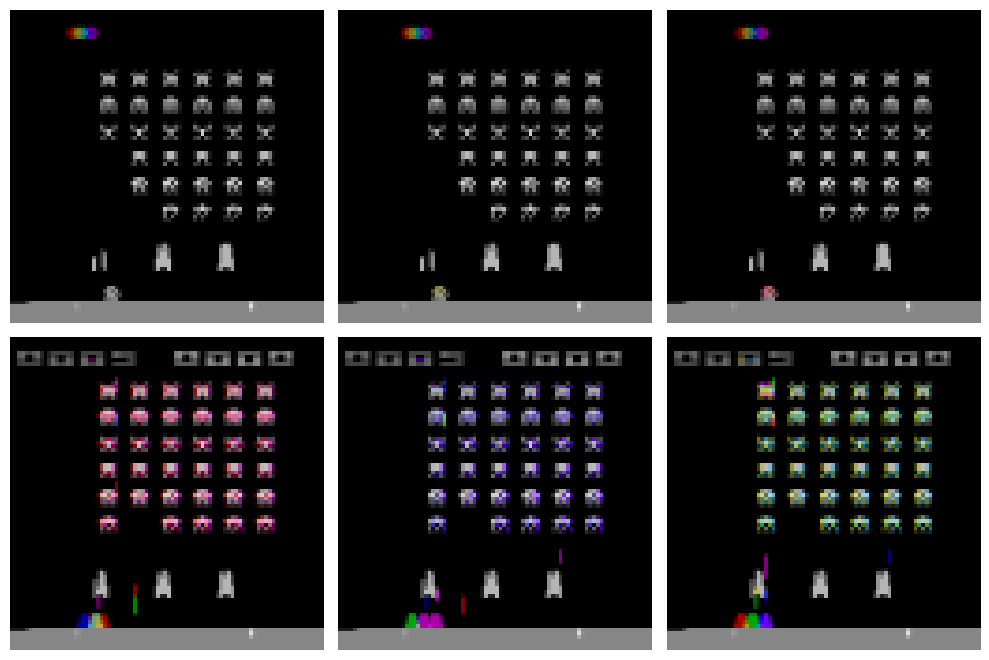

In [42]:
plt.figure(figsize=(10, 6.8))
for row in range(2):
    for col in range(3):
        plt.subplot(2, 3, row * 3 + col + 1)
        plot_observation(trajectories.observation[row, col].numpy())
plt.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0, wspace=0.02)
save_fig("sub_episodes_plot")
plt.show()


In [43]:
dataset = replay_buffer.as_dataset(
    sample_batch_size=64,
    num_steps=2,
    num_parallel_calls=3).prefetch(3)


In [44]:
from tf_agents.utils.common import function

collect_driver.run = function(collect_driver.run)
agent.train = function(agent.train)

In [45]:
def train_agent(n_iterations):
    time_step = None
    policy_state = agent.collect_policy.get_initial_state(tf_env.batch_size)
    iterator = iter(dataset)
    for iteration in range(n_iterations):
        time_step, policy_state = collect_driver.run(time_step, policy_state)
        trajectories, buffer_info = next(iterator)
        train_loss = agent.train(trajectories)
        print("\r{} loss:{:.5f}".format(
            iteration, train_loss.loss.numpy()), end="")
        if iteration % 1000 == 0:
            log_metrics(train_metrics)
        # print("iteration: ", iteration)

def beep_when_finished():
    b = jupyter_beeper.Beeper()
    for i in range(3):
        b.beep(frequency=530, secs=0.7, blocking=True)
        

In [1]:
start_time = time.time()
train_agent(n_iterations=10)
print("\nTime Taken: ", time.time() - start_time)
beep_when_finished()

from tf_agents.utils import common
from tf_agents.policies import policy_saver

def define_saving_modules(agent, replay_buffer, global_step):
    # common_dir = "./saved_model_files"
    checkpoint_dir = os.path.join(os.getcwd(), "checkpoint")
    train_checkpointer = common.Checkpointer(
        ckpt_dir = checkpoint_dir,
        max_to_keep = 1,
        agent = agent,
        policy = agent.policy,
        replay_buffer = replay_buffer,
        global_step = global_step
    )
    
    # policy_dir = os.path.join(common_dir, 'policy')
    tf_policy_saver = policy_saver.PolicySaver(agent.policy)

    return train_checkpointer, tf_policy_saver

def save_models(train_checkpointer, tf_policy_saver, global_step, policy_dir):
    train_checkpointer.save(global_step)
    tf_policy_saver.save(policy_dir)

    
policy_dir = os.path.join(os.getcwd(), 'policy')
train_checkpointer, tf_policy_saver = define_saving_modules(agent, replay_buffer, train_step)
save_models(train_checkpointer, tf_policy_saver, train_step, policy_dir)

NameError: name 'time' is not defined

In [ ]:
# import jupyter_beeper
# import time

# b = jupyter_beeper.Beeper()

# # Default config is frequency=440 Hz, secs=0.7 seconds, and
# # blocking=False (b.beep() will return when the sound begins)
# b.beep()

# # We have to put a sleep statement, since the previous call 
# # for b.beep() is non blocking, and then it will overlap with
# # the next call to b.beep()
# time.sleep(2)

# # This will not return until the beep is completed
# b.beep(frequency=530, secs=0.7, blocking=True)
# b.beep(frequency=530, secs=0.7, blocking=True)

In [ ]:
from tf_agents.utils import common
from tf_agents.policies import policy_saver

def define_saving_modules(agent, replay_buffer, global_step):
    # common_dir = "./saved_model_files"
    checkpoint_dir = os.path.join(os.getcwd(), "checkpoint")
    train_checkpointer = common.Checkpointer(
        ckpt_dir = checkpoint_dir,
        max_to_keep = 1,
        agent = agent,
        policy = agent.policy,
        replay_buffer = replay_buffer,
        global_step = global_step
    )
    
    # policy_dir = os.path.join(common_dir, 'policy')
    tf_policy_saver = policy_saver.PolicySaver(agent.policy)

    return train_checkpointer, tf_policy_saver

def save_models(train_checkpointer, tf_policy_saver, global_step, policy_dir):
    train_checkpointer.save(global_step)
    tf_policy_saver.save(policy_dir)

    
policy_dir = os.path.join(os.getcwd(), 'policy')
train_checkpointer, tf_policy_saver = define_saving_modules(agent, replay_buffer, train_step)
save_models(train_checkpointer, tf_policy_saver, train_step, policy_dir)

In [48]:
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim


# log_metrics(train_metrics)
# print(log_metrics(train_metrics))

In [49]:
# from tf_agents.eval.metric_utils import compute_summaries

# res = compute_summaries(
#     metrics = train_metrics,
#     environment=tf_env,
#     policy=agent.policy,
#     num_episodes=1,
#     global_step=None,
#     tf_summaries=True,
#     log=False,
#     callback=None
# )
# print(res)

In [51]:
frames = []
def save_frames(trajectory):
    global frames
    frames.append(tf_env.pyenv.envs[0].render(mode="rgb_array"))

num_frames = 1000
    
watch_driver = DynamicStepDriver(
    tf_env,
    agent.policy,
    observers=[save_frames, ShowProgress(num_frames)],
    num_steps=num_frames)
final_time_step, final_policy_state = watch_driver.run()

plot_animation(frames)

900/1000

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


1000/1000

In [52]:
import PIL

gif_name = "space_invaders_2M_9.gif" 

image_path = os.path.join("images", "rl", gif_name)
# frame_images = [PIL.Image.fromarray(frame) for frame in frames[:150]]
frame_images = [PIL.Image.fromarray(frame) for frame in frames]
frame_images[0].save(image_path, format='GIF',
                     append_images=frame_images[1:],
                     save_all=True,
                     duration=30,
                     loop=0)

In [142]:
%%html
# gif_dir = "images/rl/" + gif_name
<img src="images/rl/space_invaders_2M_9.gif" />